In [35]:
import numpy as np
import sys
import os
import pandas as pd
sys.path.append(os.path.join(os.getcwd(), "src"))
from sklearn.datasets import fetch_openml
from sklearn.model_selection import train_test_split
from sklearn.utils import check_random_state
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from ffnn import FFNN

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import f1_score, confusion_matrix, classification_report, log_loss, roc_auc_score, cohen_kappa_score, precision_recall_fscore_support

# Load Data

In [36]:
# Load data from https://www.openml.org/d/554
X, y = fetch_openml("mnist_784", version=1, return_X_y=True, as_frame=False)

In [37]:
print(X.shape)
print(y.shape) 

(70000, 784)
(70000,)


In [38]:
random_state = check_random_state(0)
permutation = random_state.permutation(X.shape[0])
X = X[permutation]
y = y[permutation]
X = X.reshape((X.shape[0], -1))

# one-hot encode labels
encoder = OneHotEncoder(sparse=False, categories='auto')
y_encoded = encoder.fit_transform(y.reshape(-1, 1))

# train-test split
X_train, X_val, y_train, y_val = train_test_split(X, y_encoded, test_size=0.2, random_state=42)


# Function

In [39]:
def validate_model(model, y_val_encoded, y_val_pred, y_val_pred_proba, label_encoder):
  # Precision, Recall, F1-Score (Weighted and Macro)
  precision, recall, f1, _ = precision_recall_fscore_support(
      y_val_encoded, y_val_pred, average='weighted')
  macro_f1 = f1_score(y_val_encoded, y_val_pred, average='macro')
  print(f"Weighted F1-Score: {f1:.4f}")
  print(f"Macro F1-Score: {macro_f1:.4f}")

  # Cohen's Kappa
  kappa = cohen_kappa_score(y_val_encoded, y_val_pred)
  print(f"Cohen's Kappa: {kappa:.4f}")

  # ROC-AUC (One-vs-Rest for Multi-Class)
  try:
      roc_auc = roc_auc_score(y_val_encoded, y_val_pred_proba, multi_class='ovr', average='weighted')
      print(f"ROC-AUC (Weighted): {roc_auc:.4f}")
  except ValueError:
      print("ROC-AUC could not be computed for this dataset.")

  # Log Loss
  logloss = log_loss(y_val_encoded, y_val_pred_proba)
  print(f"\nValidation Log Loss: {logloss:.4f}")


  # Classfication Report
  print("\nClassification Report:")
  print(classification_report(label_encoder.inverse_transform(y_val_encoded),
                              label_encoder.inverse_transform(y_val_pred),
                              target_names=[str(cls) for cls in label_encoder.classes_] ))

  # Confusion Matrix
  print()
  conf_matrix_id3 = confusion_matrix(label_encoder.inverse_transform(y_val_encoded),
                                    label_encoder.inverse_transform(y_val_pred),
                                    labels=label_encoder.classes_)

  plt.figure(figsize=(8, 6))
  sns.heatmap(conf_matrix_id3, annot=True, fmt='d', cmap='Blues',
              xticklabels=[str(cls) for cls in label_encoder.classes_], 
              yticklabels=[str(cls) for cls in label_encoder.classes_])
  plt.xlabel('Predicted Labels')
  plt.ylabel('True Labels')
  plt.title('Confusion Matrix')
  plt.show()



# Create Model

In [40]:
layer_sizes = [784, 128, 64, 10] 
activation_funcs = ["relu", "relu", "softmax"] 
model = FFNN(layer_sizes, activation_funcs=activation_funcs, weight_init="he", loss_function="cce", seed=42)

# model training
history = model.train(
    X_train, y_train,
    X_val=X_val, y_val=y_val,
    batch_size=64,
    learning_rate=0.001,
    epochs=10,
    verbose=1
)

Epoch 1/10 - loss: 1.5954 - val_loss: 0.8476
Epoch 2/10 - loss: 0.6304 - val_loss: 0.5649
Epoch 3/10 - loss: 0.4509 - val_loss: 0.4430
Epoch 4/10 - loss: 0.3643 - val_loss: 0.3908
Epoch 5/10 - loss: 0.3206 - val_loss: 0.3557
Epoch 6/10 - loss: 0.2894 - val_loss: 0.3425
Epoch 7/10 - loss: 0.2680 - val_loss: 0.3248
Epoch 8/10 - loss: 0.2490 - val_loss: 0.3192
Epoch 9/10 - loss: 0.2363 - val_loss: 0.3387
Epoch 10/10 - loss: 0.2236 - val_loss: 0.3006


In [41]:
predictions = model.predict(X_val)

label_encoder = LabelEncoder()
label_encoder.fit(np.arange(10))

y_val_encoded = np.argmax(y_val, axis=1)
y_val_pred = np.argmax(predictions, axis=1) 
y_val_pred_proba = predictions

Weighted F1-Score: 0.9200
Macro F1-Score: 0.9188
Cohen's Kappa: 0.9110
ROC-AUC (Weighted): 0.9941

Validation Log Loss: 0.3006

Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.97      0.96      1402
           1       0.96      0.97      0.97      1556
           2       0.91      0.94      0.92      1368
           3       0.93      0.84      0.88      1339
           4       0.92      0.93      0.92      1395
           5       0.84      0.90      0.87      1261
           6       0.96      0.94      0.95      1418
           7       0.95      0.89      0.92      1463
           8       0.88      0.91      0.89      1362
           9       0.88      0.92      0.90      1436

    accuracy                           0.92     14000
   macro avg       0.92      0.92      0.92     14000
weighted avg       0.92      0.92      0.92     14000




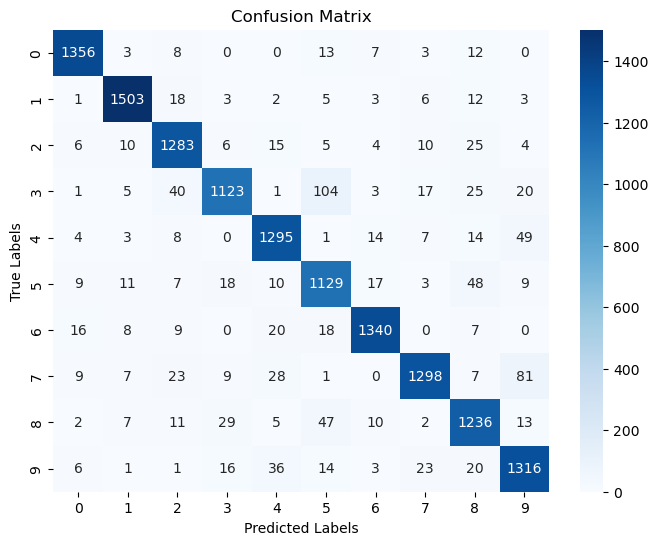

In [42]:
validate_model(model, y_val_encoded, y_val_pred, y_val_pred_proba, label_encoder)


In [43]:
#model.visualize_model()
model.visualize_weight_distribution()
model.visualize_gradient_weight_distribution()
model.visualize_loss_curve()

# Testing

## Pengaruh Learning Rate

In [44]:
print("\n==== Testing Different Activation Functions ====")

histories = {
        'history': [],
        'accuracy': [],
        'model' : []
    }
layer_sizes = [784, 128, 64, 10] 
activation_functions = ["relu", "sigmoid", "tanh", "linear"]
for activation in activation_functions:
    print(f"\nTraining with activation function: {activation}")
    
    # For all tests, use sigmoid in the output layer with MSE loss
    activation_funcs = [activation, activation, "softmax"]
    
    # Initialize model
    model = FFNN(
        layer_sizes=layer_sizes,
        activation_funcs=activation_funcs,
        weight_init="he",
        loss_function="cce",
        seed=42
    )
    
    # Train model and time it
    history = model.train(
        X_train, y_train,
        X_val=X_val, y_val=y_val,
        batch_size=64,
        learning_rate=0.001,
        epochs=20,
        verbose=0
    )
    
    # Get predictions on test set
    y_pred = model.predict(X_val)
    
    # Calculate accuracy - get argmax for one-hot encoded outputs
    y_test_labels = np.argmax(y_val, axis=1)
    y_pred_labels = np.argmax(y_pred, axis=1)
    accuracy = np.mean(y_val_pred == y_val_encoded)
    
    print(f"Test accuracy: {accuracy:.4f}")
    print(history["train_loss"][19])
    print(history["val_loss"][19])
    
    # Store history and model
    histories[activation] = {
        'history': history,
        'accuracy': accuracy,
        'model': model
    }


==== Testing Different Activation Functions ====

Training with activation function: relu
Test accuracy: 0.9199
0.15088285214367905
0.2597051354785734

Training with activation function: sigmoid


c:\Users\Keanu\Documents\GitHub\Tubes1ML_G07_SSB\src\activation_function.py:13: RuntimeWarning:

overflow encountered in exp

c:\Users\Keanu\Documents\GitHub\Tubes1ML_G07_SSB\src\activation_turunan.py:14: RuntimeWarning:

overflow encountered in exp



Test accuracy: 0.9199
0.723192657093452
0.7199043104255133

Training with activation function: tanh
Test accuracy: 0.9199
0.2652683411376742
0.2997298685968794

Training with activation function: linear
Test accuracy: 0.9199
nan
nan


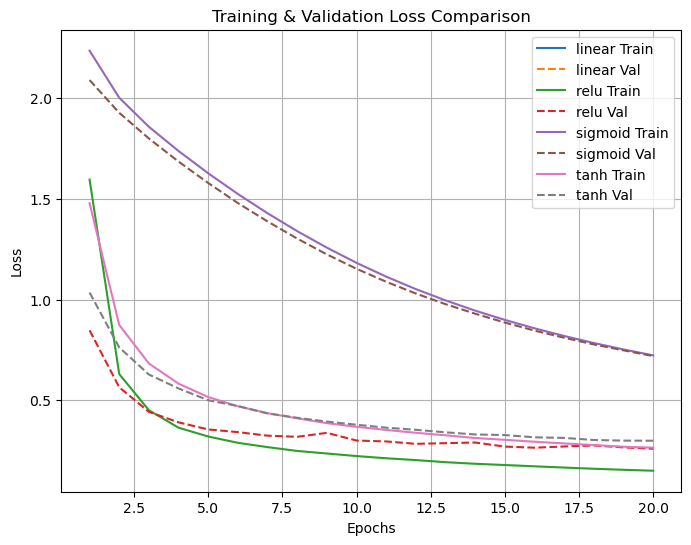

Visualisasi activation relu


Weighted F1-Score: 0.9364
Macro F1-Score: 0.9356
Cohen's Kappa: 0.9293
ROC-AUC (Weighted): 0.9953

Validation Log Loss: 0.2597

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1402
           1       0.96      0.97      0.97      1556
           2       0.92      0.95      0.93      1368
           3       0.93      0.90      0.92      1339
           4       0.94      0.93      0.94      1395
           5       0.88      0.93      0.91      1261
           6       0.96      0.95      0.96      1418
           7       0.94      0.93      0.94      1463
           8       0.93      0.90      0.91      1362
           9       0.93      0.92      0.92      1436

    accuracy                           0.94     14000
   macro avg       0.94      0.94      0.94     14000
weighted avg       0.94      0.94      0.94     14000




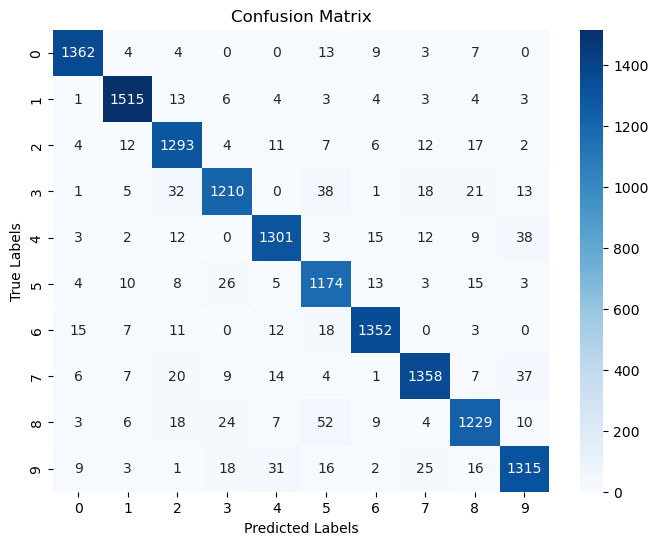

Visualisasi activation sigmoid


c:\Users\Keanu\Documents\GitHub\Tubes1ML_G07_SSB\src\activation_function.py:13: RuntimeWarning:

overflow encountered in exp



Weighted F1-Score: 0.8621
Macro F1-Score: 0.8600
Cohen's Kappa: 0.8482
ROC-AUC (Weighted): 0.9850

Validation Log Loss: 0.7199

Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      1402
           1       0.92      0.97      0.95      1556
           2       0.86      0.88      0.87      1368
           3       0.78      0.84      0.81      1339
           4       0.85      0.88      0.87      1395
           5       0.83      0.75      0.79      1261
           6       0.89      0.92      0.91      1418
           7       0.88      0.87      0.87      1463
           8       0.86      0.74      0.79      1362
           9       0.84      0.79      0.81      1436

    accuracy                           0.86     14000
   macro avg       0.86      0.86      0.86     14000
weighted avg       0.86      0.86      0.86     14000




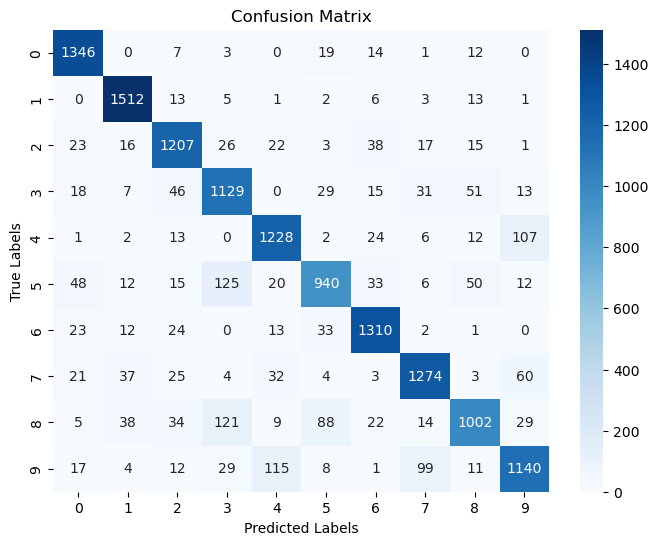

Visualisasi activation tanh


Weighted F1-Score: 0.9122
Macro F1-Score: 0.9109
Cohen's Kappa: 0.9026
ROC-AUC (Weighted): 0.9937

Validation Log Loss: 0.2997

Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.97      0.95      1402
           1       0.97      0.98      0.97      1556
           2       0.91      0.91      0.91      1368
           3       0.87      0.88      0.87      1339
           4       0.90      0.93      0.92      1395
           5       0.87      0.88      0.87      1261
           6       0.95      0.94      0.94      1418
           7       0.93      0.90      0.92      1463
           8       0.89      0.85      0.87      1362
           9       0.88      0.89      0.88      1436

    accuracy                           0.91     14000
   macro avg       0.91      0.91      0.91     14000
weighted avg       0.91      0.91      0.91     14000




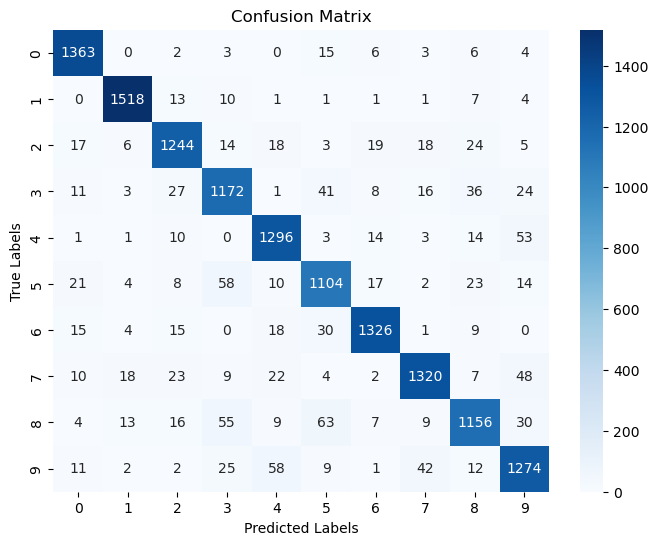

In [52]:
# Plot 1: Training and Validation Loss comparison
plt.figure(figsize=(8, 6))
for activation in activation_functions:
    plt.plot(range(1, 21), histories[activation]['history']['train_loss'], label=f"{activation} Train")
    plt.plot(range(1, 21), histories[activation]['history']['val_loss'], linestyle="dashed", label=f"{activation} Val")

plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training & Validation Loss Comparison")
plt.legend()
plt.grid(True)
plt.show()

for activation in activation_functions:
    if activation != "linear":
        print(f"Visualisasi activation {activation}")
        model = histories[activation]["model"]
        model.visualize_weight_distribution()
        model.visualize_gradient_weight_distribution()

        predictions = model.predict(X_val)

        label_encoder = LabelEncoder()
        label_encoder.fit(np.arange(10))

        y_val_encoded = np.argmax(y_val, axis=1)
        y_val_pred = np.argmax(predictions, axis=1) 
        y_val_pred_proba = predictions
        validate_model(model, y_val_encoded, y_val_pred, y_val_pred_proba, label_encoder)

        

## Pengaruh Fungsi AKtivasi